In [66]:
import powerlaw
import pandas as pd
import numpy as np
import pickle
import os
import seaborn as sns
###

from scipy.stats import pearsonr, zscore
from MFDFA import fgn
# Plot settings
%matplotlib inline
%config InlineBackend.figure_format = 'svg'
sns.set()
from tqdm import tqdm


import matplotlib as mpl
from matplotlib import pyplot as plt
from matplotlib import cm
import stylised_facts.stylised_facts_data_utilities.createLOB as createLOB
import stylised_facts.stylised_facts_data_utilities.gpyNARX as gpyNARX
%matplotlib inline

from scipy.stats import gamma, expon, fatiguelife
import pylab
pylab.rcParams['xtick.major.pad']='8'
pylab.rcParams['ytick.major.pad']='8'
#pylab.rcParams['font.sans-serif']='Arial'

from matplotlib import rc
rc('font', family='sans-serif')
rc('font', size=10.0)
rc('text', usetex=False)


from matplotlib.font_manager import FontProperties

panel_label_font = FontProperties().copy()
panel_label_font.set_weight("bold")
panel_label_font.set_size(12.0)
panel_label_font.set_family("sans-serif")

In [65]:
def plot_basics(data, data_inst, fig, units):
    from powerlaw import plot_pdf, Fit, pdf
    annotate_coord = (-.4, .95)
    ax1 = fig.add_subplot(n_graphs,n_data,data_inst)
    x, y = pdf(data, linear_bins=True)
    ind = y>0
    y = y[ind]
    x = x[:-1]
    x = x[ind]
    ax1.scatter(x, y, color='r', s=.5)
    plot_pdf(data[data>0], ax=ax1, color='b', linewidth=2)
    from pylab import setp
    setp( ax1.get_xticklabels(), visible=False)

    if data_inst==1:
        ax1.annotate("A", annotate_coord, xycoords="axes fraction", fontproperties=panel_label_font)

    
    from mpl_toolkits.axes_grid.inset_locator import inset_axes
    ax1in = inset_axes(ax1, width = "30%", height = "30%", loc=3)
    ax1in.hist(data, normed=True, color='b')
    ax1in.set_xticks([])
    ax1in.set_yticks([])

    
    ax2 = fig.add_subplot(n_graphs,n_data,n_data+data_inst, sharex=ax1)
    plot_pdf(data, ax=ax2, color='b', linewidth=2)
    fit = Fit(data, xmin=1, discrete=True)
    fit.power_law.plot_pdf(ax=ax2, linestyle=':', color='g')
    p = fit.power_law.pdf()

    ax2.set_xlim(ax1.get_xlim())
    
    fit = Fit(data, discrete=True)
    fit.power_law.plot_pdf(ax=ax2, linestyle='--', color='g')
    from pylab import setp
    setp( ax2.get_xticklabels(), visible=False)

    if data_inst==1:
       ax2.annotate("B", annotate_coord, xycoords="axes fraction", fontproperties=panel_label_font)        
       ax2.set_ylabel(u"p(X)")# (10^n)")
        
    ax3 = fig.add_subplot(n_graphs,n_data,n_data*2+data_inst)#, sharex=ax1)#, sharey=ax2)
    fit.power_law.plot_pdf(ax=ax3, linestyle='--', color='g')
    fit.exponential.plot_pdf(ax=ax3, linestyle='--', color='r')
    fit.plot_pdf(ax=ax3, color='b', linewidth=2)
    
    ax3.set_ylim(ax2.get_ylim())
    ax3.set_xlim(ax1.get_xlim())
    
    if data_inst==1:
        ax3.annotate("C", annotate_coord, xycoords="axes fraction", fontproperties=panel_label_font)

    ax3.set_xlabel(units)

In [67]:
## get cwd directory where all combined DataFrames are ##
OHLCData= '/media/ak/My Passport/Experiment Data/OHLCData/'
print(powerlaw.__version__)

1.4.4


In [116]:
symbols =['FB1','JB1','FV1','G_1']
# combinedDFLoc = "/".join((OHLCData,str(symbol)+'CombinedDF.csv'))
symbolIdx = 1
symbolFilesList =[s for s in os.listdir(OHLCData) if (str(symbols[symbolIdx])+'CombinedDF') in s]
print(symbols[symbolIdx])

JB1


In [117]:
symbolCombinedDfLoc= "/".join((OHLCData, symbolFilesList[0])) #location of file
combinedDF = pd.read_csv(symbolCombinedDfLoc) #read the combined DF

In [118]:
combinedDF.head(2)

,End,Start,Open,High,Low,Close
0,9,4,150.89,150.89,150.89,150.89
1,14,9,150.89,150.89,150.89,150.89


In [119]:
# compute the estimators
rogersSatchell=createLOB.Volestim(combinedDF).rogersSatchell()
hodgesTompkins=createLOB.Volestim(combinedDF).hodgesTompkins()
yangZhang = createLOB.Volestim(combinedDF).yangZhang()
simpleVol = createLOB.Volestim(combinedDF).simpleVol()

 /home/ak/Documents/Research/PaperCode/stylised_facts/stylised_facts_data_utilities/createLOB/__init__.py:392: FutureWarning:Currently, 'apply' passes the values as ndarrays to the applied function. In the future, this will change to passing it as Series objects. You need to specify 'raw=True' to keep the current behaviour, and you can pass 'raw=False' to silence this warning


In [120]:
volsDF= pd.DataFrame()
volsDF['RogersSatchell'] = rogersSatchell
volsDF['HodgesTompkins'] = hodgesTompkins
volsDF['SimpleVol'] = simpleVol
volsDF['yangZhang'] = yangZhang

No handles with labels found to put in legend.


Text(0.5, 1.0, 'Simple Vol Estimation')

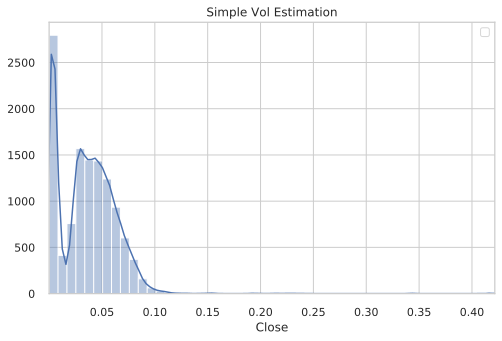

In [121]:
sns.set(style="whitegrid")    
_=fig, ax = plt.subplots(figsize=(8, 5))    
palette = sns.color_palette("bright", 4)
g =sns.distplot(simpleVol);
_=g.legend(bbox_to_anchor=(1, 1), ncol=1)
_=g.set(xlim = (np.min(simpleVol),np.max(simpleVol)))
_=xlabels = ['{:,.2f}'.format(x) + '' for x in g.get_xticks()*100]
_=g.set_xticklabels(xlabels)
plt.title('Simple Vol Estimation')

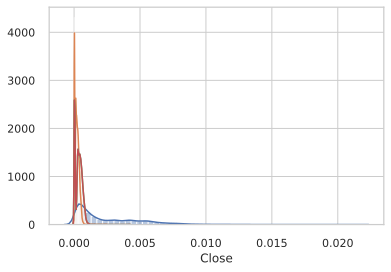

In [122]:
sns.distplot(rogersSatchell,label='Rogers Satchell');
sns.distplot(yangZhang);
sns.distplot(simpleVol);
sns.distplot(hodgesTompkins)

No handles with labels found to put in legend.


Text(0.5, 1.0, 'Rogers Satchell Volatility Estimation')

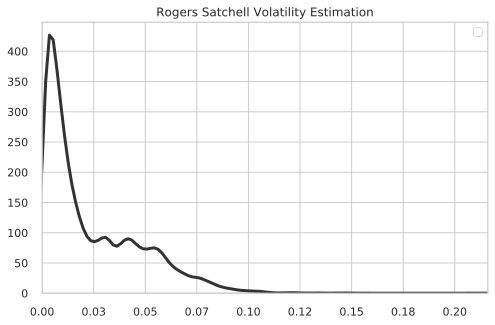

In [123]:
sns.set(style="whitegrid")    
_=fig, ax = plt.subplots(figsize=(8, 5))    
palette = sns.color_palette("bright", 4)
g=sns.kdeplot(rogersSatchell, color=".2", linewidth=3);
_=g.legend(bbox_to_anchor=(1, 1), ncol=1)
_=g.set(xlim = (np.min(rogersSatchell),np.max(rogersSatchell)))
_=xlabels = ['{:,.2f}'.format(x) + '' for x in g.get_xticks()*10]
_=g.set_xticklabels(xlabels)
plt.title('Rogers Satchell Volatility Estimation')

In [126]:
volsDF.columns

Index(['RogersSatchell', 'HodgesTompkins', 'SimpleVol', 'yangZhang'], dtype='object')

In [ ]:
import seaborn as sns
from seaborn_qqplot import qqplot
qqplot(volsDF, x='RogersSatchell', y=fatiguelife, height = 4, aspect = 1.5, display_kws={"identity":True})
qqplot(volsDF, x='RogersSatchell', y=expon, height = 4, aspect = 1.5, display_kws={"identity":True})
qqplot(volsDF.dropna(), x='yangZhang', y=fatiguelife, height = 4, aspect = 1.5, display_kws={"identity":True})
qqplot(volsDF.dropna(), x='yangZhang', y=expon, height = 4, aspect = 1.5, display_kws={"identity":True})


In [ ]:
volsDF.columns.values

In [ ]:
import powerlaw
data = np.asarray(volsDF.RogersSatchell)# data can be list or numpy array
results = powerlaw.Fit(data,discrete=False)
print(results.power_law.alpha)
print(results.power_law.xmin)
R, p = results.distribution_compare('power_law', 'lognormal')


In [ ]:
def SurvivalPlot(df, symbol, estimator):
    data = np.asarray(df[str(estimator)].dropna())# data can be list or numpy array
    results = powerlaw.Fit(data,discrete=False)
    fig =results.plot_pdf( color='r')
    FigCCDFmax =results.plot_ccdf(color='b', label=r"Empirical, no $x_{max}$")
    results.plot_ccdf(linewidth=2, linestyle='dotted', label='Empirical Data')

    fig.set_ylabel("p(X)")
    fig.set_xlabel(r"Frequency")
    fig.xaxis.set_tick_params(labelsize=6)
    fig.yaxis.set_tick_params(labelsize=6)
    
    plt.title('Survival Function for '+str(estimator)+ ' estimator. Symbol: '+str(symbol))
    plt.savefig('/home/ak/Documents/Research/Papers/figures/' + str(estimator)+'CCDFTail' +str(symbol)+ '.png', dpi=150)
    plt.show()
    return plt, fig

In [ ]:
# def (df, symbol, estimator):
df=volsDF
symbol=symbols[symbolIdx]
estimator='SimpleVol'
data = np.asarray(df[str(estimator)].dropna())# data can be list or numpy array
fit = powerlaw.Fit(data, discrete=True)
####
figCCDF = fit.plot_pdf(color='b', linewidth=2)
fit.power_law.plot_pdf(color='b', linestyle='--', ax=figCCDF)
fit.plot_ccdf(color='r', linewidth=2, ax=figCCDF)
fit.power_law.plot_ccdf(color='r', linestyle='--', ax=figCCDF)
####
figCCDF.set_tick_params(labelsize=6)
figCCDF.set_ylabel(u"p(X),  p(X≥x)", fontsize =10)
figCCDF.set_xlabel(r"Frequency", fontsize =8)


# figname = 'FigCCDF'
# savefig(figname+'.eps', bbox_inches='tight')
#savefig(figname+'.tiff', bbox_inches='tight', dpi=300)

In [ ]:
df=volsDF
symbol=symbols[symbolIdx]
estimator='SimpleVol'

data = np.asarray(df[str(estimator)].dropna())# data can be list or numpy array
#FigCCDFmax = powerlaw.plot_ccdf(data, linewidth=3)
fit = powerlaw.Fit(data, discrete=True, xmax=None)
FigCCDFmax = fit.plot_ccdf(color='b', label=r"Empirical, no $x_{max}$")
fit.power_law.plot_ccdf(color='b', linestyle='--', ax=FigCCDFmax, label=r"Fit, no $x_{max}$")
fit = powerlaw.Fit(data, discrete=True, xmax=1000)
fit.plot_ccdf(color='r', label=r"Empirical, $x_{max}=1000$")
fit.power_law.plot_ccdf(color='r', linestyle='--', ax=FigCCDFmax, label=r"Fit, $x_{max}=1000$")
#x, y = powerlaw.ccdf(data, xmax=max(data))
#fig1.plot(x,y)
####
#FigCCDFmax.set_ylabel(r"$p(X\geq x)$")
FigCCDFmax.set_ylabel(u"p(X≥x)")
FigCCDFmax.set_xlabel(r"Volatility Frequency")
handles, labels = FigCCDFmax.get_legend_handles_labels()
leg = FigCCDFmax.legend(handles, labels, loc=3)
leg.draw_frame(False)

# figname = 'FigCCDFmax'
# savefig(figname+'.eps', bbox_inches='tight')
#savefig(figname+'.tiff', bbox_inches='tight', dpi=300)

In [ ]:
SurvivalPlot(df=volsDF, symbol=symbols[symbolIdx], estimator='RogersSatchell')

In [ ]:
volsDF.columns.values

In [ ]:
SurvivalPlot(df=volsDF, symbol=symbols[symbolIdx], estimator='yangZhang')

In [ ]:
data = volsDF.RogersSatchell.values
####
figPDF = powerlaw.plot_pdf(data, color='b')
powerlaw.plot_pdf(data, linear_bins=True, color='r', ax=figPDF)
####
figPDF.set_ylabel("p(X)")
figPDF.set_xlabel(r"RogersSatchell")
figname = 'RogerSatchellFigPDF'
plt.savefig(figname+'.eps', bbox_inches='tight')
#savefig(figname+'.tiff', bbox_inches='tight', dpi=300)